# Tugas Analisis Multimedia: Exercise - Audio Processing

**Mata Kuliah:** Sistem & Teknologi Multimedia  
**Nama:** Reynaldi Cristian Simamora   
**NIM:** 122140116  

Tautan Repositori Github : https://github.com/anzensirc/Worksheet-Sistem-Teknologi-Multimedia

---

## Deskripsi Tugas

Tugas ini dirancang untuk menguji pemahaman mahasiswa terhadap konsep-konsep fundamental dalam pemrosesan audio digital, termasuk manipulasi sinyal audio, filtering,
pitch shifting, normalisasi, dan teknik remix audio. Mahasiswa diharapkan dapat menerapkan teori yang telah dipelajari dalam praktik langsung menggunakan Python dan
pustaka pemrosesan audio.

---


In [3]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import librosa
import soundfile as sf
from PIL import Image
import cv2
from IPython.display import Audio, HTML, display
import os

# Set matplotlib untuk menampilkan plot inline
%matplotlib inline

# Tampilkan versi library untuk dokumentasi
print("Library versions:")
print(f"NumPy: {np.__version__}")
print(f"Matplotlib: {matplotlib.__version__}")
print(f"Librosa: {librosa.__version__}")
print(f"OpenCV: {cv2.__version__}")

Library versions:
NumPy: 1.26.4
Matplotlib: 3.10.1
Librosa: 0.11.0
OpenCV: 4.11.0


# Soal Hands-On

## 1. Rekaman dan Analisis Suara Multi-Level

Rekamlah suara Anda sendiri selama **25 detik** ketika membaca sebuah teks berita.  
Dalam 25 detik rekaman tersebut, bagi suara Anda menjadi beberapa level sebagai berikut:

1. **0–5 detik:** Suara **sangat pelan / berbisik**  
2. **5–10 detik:** Suara **normal**  
3. **10–15 detik:** Suara **keras**  
4. **15–20 detik:** Suara **cempreng** (dibuat-buat cempreng)  
5. **20–25 detik:** Suara **berteriak**

---

### Tugas yang harus dilakukan:
- Rekam suara dalam format **WAV** (atau konversikan ke WAV sebelum dimuat ke notebook).  
- **Visualisasikan waveform** dan **spektrogram** dari rekaman suara Anda.  
- Sertakan **penjelasan singkat** mengenai hasil visualisasi tersebut.  
- Lakukan **resampling** pada file audio Anda kemudian **bandingkan kualitas dan durasinya**.  

**Path file:** `Audio1/audio25s.wav`

---

### Kode Pemrosesan Audio

In [4]:
import os
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio
import soundfile as sf

In [5]:
base_path = os.getcwd()
audio_path = os.path.join(base_path, "Audio1", "audio25s.wav")

y, sr = librosa.load(audio_path, sr=None)

Audio(y, rate=sr)

In [6]:
info = sf.info(audio_path)
print("=== Informasi Teknis ===")
print(info)

duration = librosa.get_duration(y=y, sr=sr)
print(f"\nSampling rate : {sr} Hz")
print(f"Durasi : {duration:.2f} detik")
print(f"Jumlah sample : {len(y)}")


=== Informasi Teknis ===
f:\STM\Worksheet3\assets\Audio1\audio25s.wav
samplerate: 48000 Hz
channels: 2
duration: 25.045 s
format: WAV (Microsoft) [WAV]
subtype: Signed 16 bit PCM [PCM_16]

Sampling rate : 48000 Hz
Durasi : 25.05 detik
Jumlah sample : 1202176


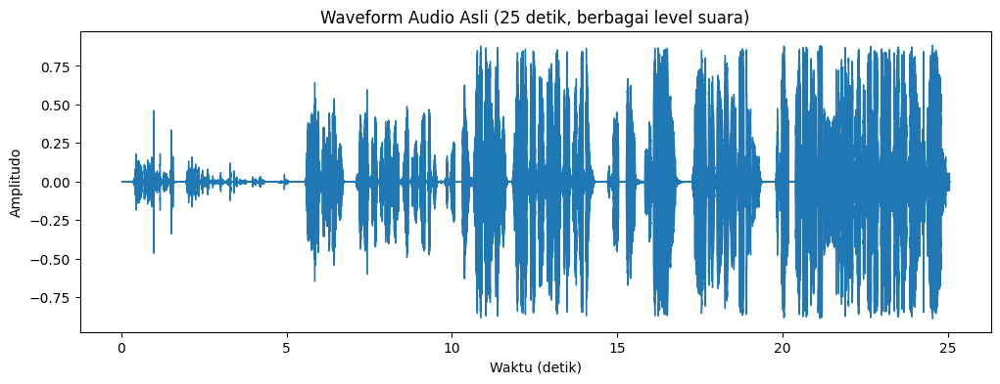

In [7]:
plt.figure(figsize=(12, 4))
librosa.display.waveshow(y, sr=sr)
plt.title("Waveform Audio Asli (25 detik, berbagai level suara)")
plt.xlabel("Waktu (detik)")
plt.ylabel("Amplitudo")
plt.show()

---

Audio yang dimuat berisi audio suara berbisik, suara normal, suara keras, suara melengking (cempreng), dan suara teriak yang berdurasi 5 detik berurutan. Dari visualisasinya, dapat dilihat 5 detik awal, hasil sinyal yang ditampilkan cendurung memiliki amplitudo yang kecil, dibanding detik seterusnya. Detik 5 hingga 10 mulai mencapai amplitudo 0,7. Dan detik 11-15, gelombang yang dihasilkan cenderung stabil dengan amplitudo yang maksimal. Sedangkan pada detik 15-20 tidak stabil, terdapat gelombang yang sangat rapat. Untuk detik terakhir 20-25, gelombang stabil dan rapat, juga mencapai amplitudo maksimal di setiap perubahan durasi. Gelombang hasil waveform cukup melambangkan suara asli yang dihasilkan.

---

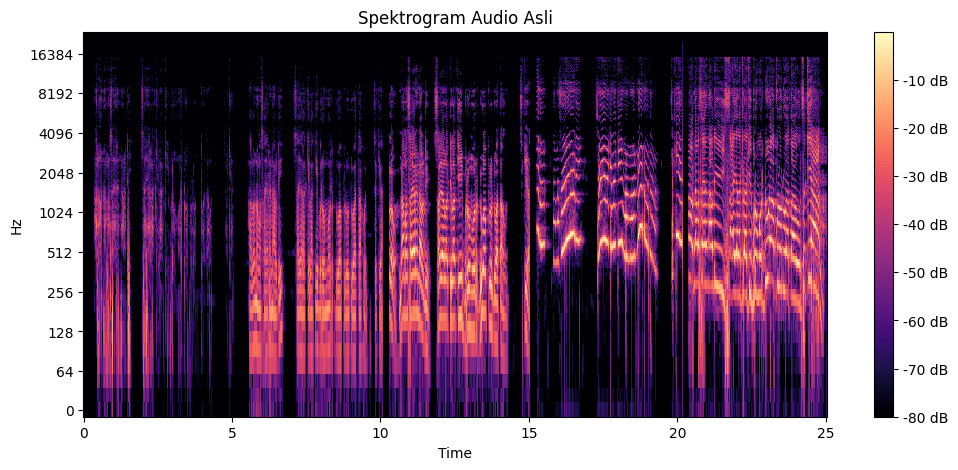

In [8]:
D = np.abs(librosa.stft(y))
DB = librosa.amplitude_to_db(D, ref=np.max)

plt.figure(figsize=(12, 5))
librosa.display.specshow(DB, sr=sr, x_axis='time', y_axis='log', cmap='magma')
plt.colorbar(format="%+2.0f dB")
plt.title("Spektrogram Audio Asli")
plt.show()

---

Di atas adalah spektogram dengan sumbu x durasi, dan sumbu y sebagai representasi frekuensi dengan satuan Heartz. Dari detik 1-5 tidak terlalu rapat suaranya yang dihasilkan, karena suara berbisik cenderung kecil. Kemudian detik 5 hingga 15 frekuensi suara berada di rentang 0- 4096 secara konsisten, dan cukup rapat karena energi pada frekuensi ini cukup besar ditandai dengan warna yang merah. Untuk detik 15-20 frekuensi suara cenderung tersebar di angka 500 keatas, dan energi suara di bawahnya rendah. Karena pada audio aslinya memang suara yang dihasilkan melengking yang dipaksakan. Untuk 5 detik terakhir frekuensi yang dihasilkan tersebar rata di 0-16000an. Energi terbesar ada di 200 hingga 2000an. Suara teriak menghasilkan sebaran frekuensi yang melonjak dari batas atas dan batas bawah, dan rapat.


---

In [9]:
# Resampling audio ke 16 kHz
y_resampled = librosa.resample(y, orig_sr=sr, target_sr=16000)

# Menyimpan hasil resampling
resampled_path = os.path.join("Audio1", "audio25s_resampled.wav")
sf.write(resampled_path, y_resampled, 16000) #menggunakan modul soundfile untuk menyimpan file audio

print("=== Metadata Sebelum Resampling ===")
info_before = sf.info(audio_path)
print(info_before)

print("\n=== Metadata Setelah Resampling ===")
info_after = sf.info(resampled_path)
print(info_after)

durasi_asli = librosa.get_duration(y=y, sr=sr)
durasi_baru = librosa.get_duration(y=y_resampled, sr=16000)

len_asli = len(y)
len_baru = len(y_resampled)

print("\n=== Perbandingan Audio ===")
print(f"Sampling rate asli : {sr} Hz")
print(f"Sampling rate baru  : 16000 Hz")
print(f"Durasi asli         : {durasi_asli:.2f} detik")
print(f"Durasi baru         : {durasi_baru:.2f} detik")
print(f"Panjang array asli  : {len_asli}")
print(f"Panjang array baru  : {len_baru}")

Audio(y_resampled, rate=16000)


=== Metadata Sebelum Resampling ===
f:\STM\Worksheet3\assets\Audio1\audio25s.wav
samplerate: 48000 Hz
channels: 2
duration: 25.045 s
format: WAV (Microsoft) [WAV]
subtype: Signed 16 bit PCM [PCM_16]

=== Metadata Setelah Resampling ===
Audio1\audio25s_resampled.wav
samplerate: 16000 Hz
channels: 1
duration: 25.045 s
format: WAV (Microsoft) [WAV]
subtype: Signed 16 bit PCM [PCM_16]

=== Perbandingan Audio ===
Sampling rate asli : 48000 Hz
Sampling rate baru  : 16000 Hz
Durasi asli         : 25.05 detik
Durasi baru         : 25.05 detik
Panjang array asli  : 1202176
Panjang array baru  : 400726


Pada proses resampling ini, saya mengambil sample rate baru yaitu 16000. Alasannya karena sebaran frekuensi terbanyak pada audio saya 128 hingga 4096. Dan berdasarkan teorema Nyquist minmal sample rate adalah 2 kali dari frekuensi maksimal audio. 16000 saya rasa cukup untuk menangkap karakterisitik audio ini.

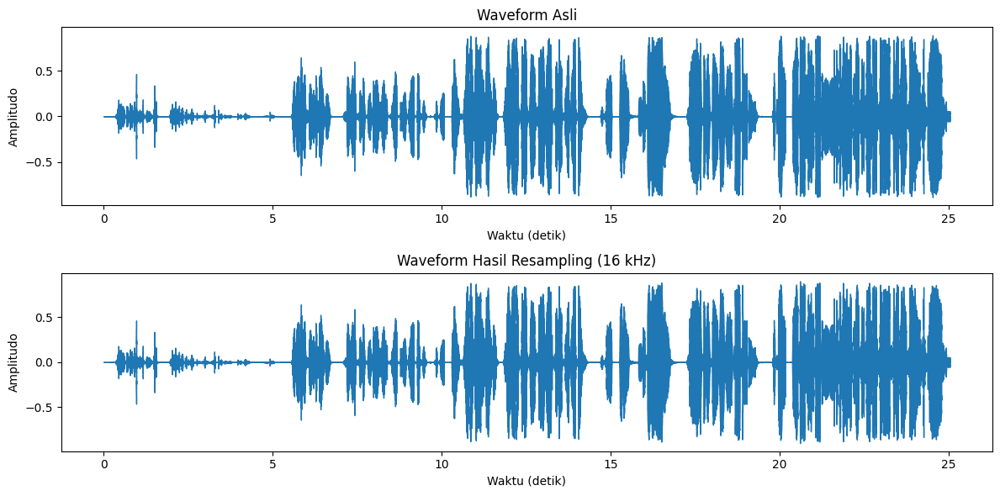

In [10]:
plt.figure(figsize=(12, 6))

# Waveform asli
plt.subplot(2, 1, 1)
librosa.display.waveshow(y, sr=sr)
plt.title("Waveform Asli")
plt.xlabel("Waktu (detik)")
plt.ylabel("Amplitudo")

# Waveform hasil resampling
plt.subplot(2, 1, 2)
librosa.display.waveshow(y_resampled, sr=16000)
plt.title("Waveform Hasil Resampling (16 kHz)")
plt.xlabel("Waktu (detik)")
plt.ylabel("Amplitudo")

plt.tight_layout()
plt.show()


Jika dilihat dari waveform tidak ada perubahan signifikan. Sedikit perubaha yang bisa dilihat kasat mata, ada di detik 20, sedikit perubahan pada gelombangnya. Namun yang pasti durasi yang tertampil tetap 25 detik. Namun kualitas waveform yang dihasilkan hampir sama dengan yang awal. Karena titiknya masih cukup banyak yaitu 16000.

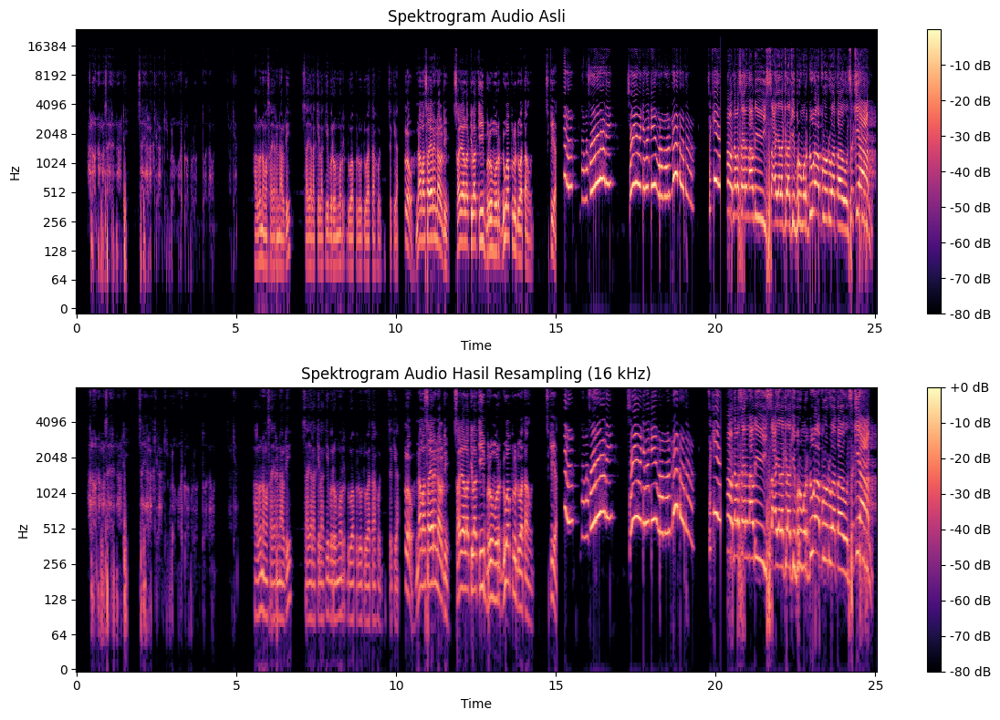

In [11]:
# Spektrogram Audio Asli dan Hasil Resampling
D_original = np.abs(librosa.stft(y))
DB_original = librosa.amplitude_to_db(D_original, ref=np.max)

D_resampled = np.abs(librosa.stft(y_resampled))
DB_resampled = librosa.amplitude_to_db(D_resampled, ref=np.max)

#Visualisasi Perbandingan
plt.figure(figsize=(12, 8))

# Spektrogram Asli
plt.subplot(2, 1, 1)
librosa.display.specshow(DB_original, sr=sr, x_axis='time', y_axis='log', cmap='magma')
plt.colorbar(format="%+2.0f dB")
plt.title("Spektrogram Audio Asli")

# Spektrogram Hasil Resampling
plt.subplot(2, 1, 2)
librosa.display.specshow(DB_resampled, sr=16000, x_axis='time', y_axis='log', cmap='magma')
plt.colorbar(format="%+2.0f dB")
plt.title("Spektrogram Audio Hasil Resampling (16 kHz)")

plt.tight_layout()
plt.show()


Kualitas gelombang yang dihasilkan sesudah resampling hampir sama, namun sekarang batas atas frekuensi berubah sehingga detail suara dengan frekuensi tinggi hilang.Untuk detik ke 5 hingga 14 lebih rapat dari gelombangnya, namun energinya sama. Warna hitam melambangkan titik frekuensi pada durasi tersebut tidak berkontribusi. Dari resampling 16000 juga menampilkan rentang frekuensi yang sesuai dengan suara manusia dengan frekuensi 64 hingga 4000an.

---

## 2. Noise Reduction dengan Filtering

Rekamlah suara Anda sendiri selama **10 detik** di sekitar objek berisik (seperti kipas angin, mesin)

---

### Tugas yang harus dilakukan:
- Lakukan filter equalisasi (high-pass, low-pass, dan band-pass) untuk menghilangkan noise.
- Gunakan berbagai nilai frekuensi cutoff (misalnya 500Hz, 1000Hz, 2000Hz)
- Visualisasikan hasil tiap filter dan bandingkan spectogramnya.
- Jelaskan noise apa yang muncul, filter mana yang paling efektif mengurangi noise, nilai cutoff mmeberikan hasil terbaik dan kualitas kejelasan suara setelah filtering.

**Path file:** `Audio2/RekamanNoise.wav`

Audio yang saya gunakan berisi noise kipas angin.

### Kode Pemrosesan Audio

In [12]:
audio_path2 = os.path.join(base_path, "Audio2", "RekamanNoise.wav")

y, sr = librosa.load(audio_path2, sr=None)

Audio(y, rate=sr)

In [13]:
info = sf.info(audio_path2)
print(info)

duration = librosa.get_duration(y=y, sr=sr)
print(f"\nSampling rate : {sr} Hz")
print(f"Durasi        : {duration:.2f} detik")
print(f"Jumlah sample : {len(y)}")

f:\STM\Worksheet3\assets\Audio2\RekamanNoise.wav
samplerate: 48000 Hz
channels: 2
duration: 10.731 s
format: WAV (Microsoft) [WAV]
subtype: Signed 16 bit PCM [PCM_16]

Sampling rate : 48000 Hz
Durasi        : 10.73 detik
Jumlah sample : 515072


In [14]:
from scipy.signal import butter, filtfilt

Modul Scipy untuk menyediakan fungsi pemrosesan sinyal digital, yang menyediakan filter Butterworth untuk proses filter pass.

✅ Disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-HP-500.wav
✅ Disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-HP-800.wav
✅ Disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-HP-1000.wav
✅ Disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-HP-2000.wav


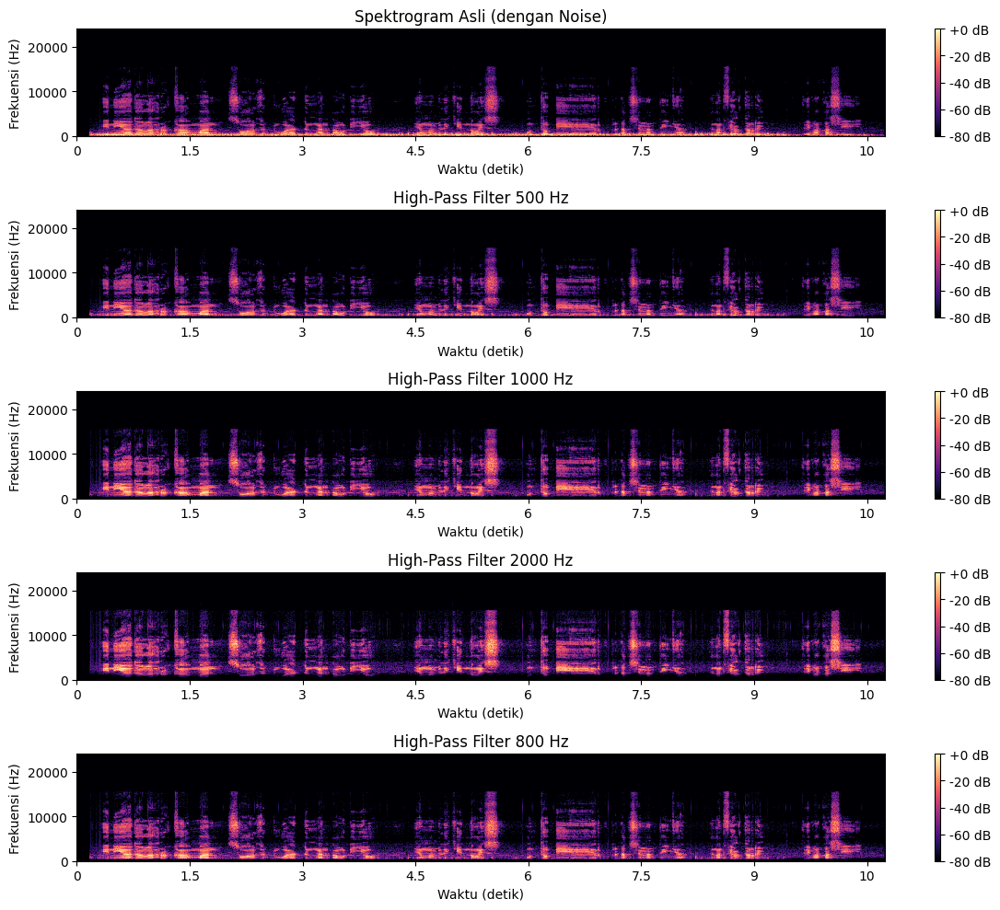

In [15]:
def butter_highpass(cutoff, fs, order=4):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    return b, a

def apply_highpass(y, cutoff, sr, order=4):
    b, a = butter_highpass(cutoff, sr, order)
    y_filtered = filtfilt(b, a, y)
    return y_filtered

cutoffs = [500, 800, 1000, 2000]  # daftar cutoff
filtered_signals = {}

output_dir = os.path.join(base_path, "Audio2", "Output")
os.makedirs(output_dir, exist_ok=True)

for c in cutoffs:
    y_f = apply_highpass(y, c, sr)
    filtered_signals[c] = y_f

    output_path = os.path.join(output_dir, f"Audio-HP-{c}.wav")
    sf.write(output_path, y_f, sr)
    print(f"✅ Disimpan: {output_path}")

def plot_spectrogram(y, sr, title):
    D = librosa.stft(y, n_fft=1024, hop_length=256)
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    librosa.display.specshow(S_db, sr=sr, hop_length=256, x_axis='time', y_axis='hz')
    plt.title(title)
    plt.xlabel("Waktu (detik)")
    plt.ylabel("Frekuensi (Hz)")
    plt.colorbar(format="%+2.0f dB")

plt.figure(figsize=(12, 10))

plt.subplot(5, 1, 1)
plot_spectrogram(y, sr, "Spektrogram Asli (dengan Noise)")

# HPF cutoff 500 Hz
plt.subplot(5, 1, 2)
plot_spectrogram(filtered_signals[500], sr, "High-Pass Filter 500 Hz")

# HPF cutoff 1000 Hz
plt.subplot(5, 1, 3)
plot_spectrogram(filtered_signals[1000], sr, "High-Pass Filter 1000 Hz")

# HPF cutoff 2000 Hz
plt.subplot(5, 1, 4)
plot_spectrogram(filtered_signals[2000], sr, "High-Pass Filter 2000 Hz")

plt.subplot(5, 1, 5)
plot_spectrogram(filtered_signals[800], sr, "High-Pass Filter 800 Hz")

plt.tight_layout()
plt.show()


Pada filter High-pass saya menggunakan 4 filter cutoof yaitu 500 Hz, 800Hz, 1000 Hz, dan 2000Hz. Fungsi filter ini adalah membatasi frekuensi di bawah dari nila cutoff. Artinya memfilter data frekuensi suara yang di bawah nilai cutoff tersebut, misalnya dalam hal ini nilai frekuensi di bawah 500 Hz dibuang dari audio. Perbandingan yang ditampilkan antara nilai cutoff 500, dan 800 Hz tidak signifikan terlihat perbedaannya, namun jika dibandingkan dengan audio awal terdapat potongan energi warna hitam di batas bawah visual yang terfilter. Pada filter cutoff 2000 Hz, terlihat banyak detail suara frekuensi batas 2000 yang berubah. Batas bawahnya tidak rata, menandakan ada detail yang tidak terambil. Namun pada 1000 cukup baik batas bawahnya cukup rata. Namun jika diputar masing masing audio terfilter, saya secara personal menilai cutoff 1000Hz yang terbaik karena noise kipas angin sudah cukup hilang, dan detail suara rendah saya masih terdengar. Sedangkan di bawahnya ada 500, dan 800 Hz masih terdengar jelas suara kipas, dan 2000 Hz detail suara rendah saya banyak yang berkurang. Jadi menurut saya sebaran frekuensi noise kipas angin ada di 800 kebawah.

---

✅ File disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-LP-500.wav
✅ File disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-LP-1000.wav
✅ File disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-LP-2000.wav
✅ File disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-LP-4500.wav


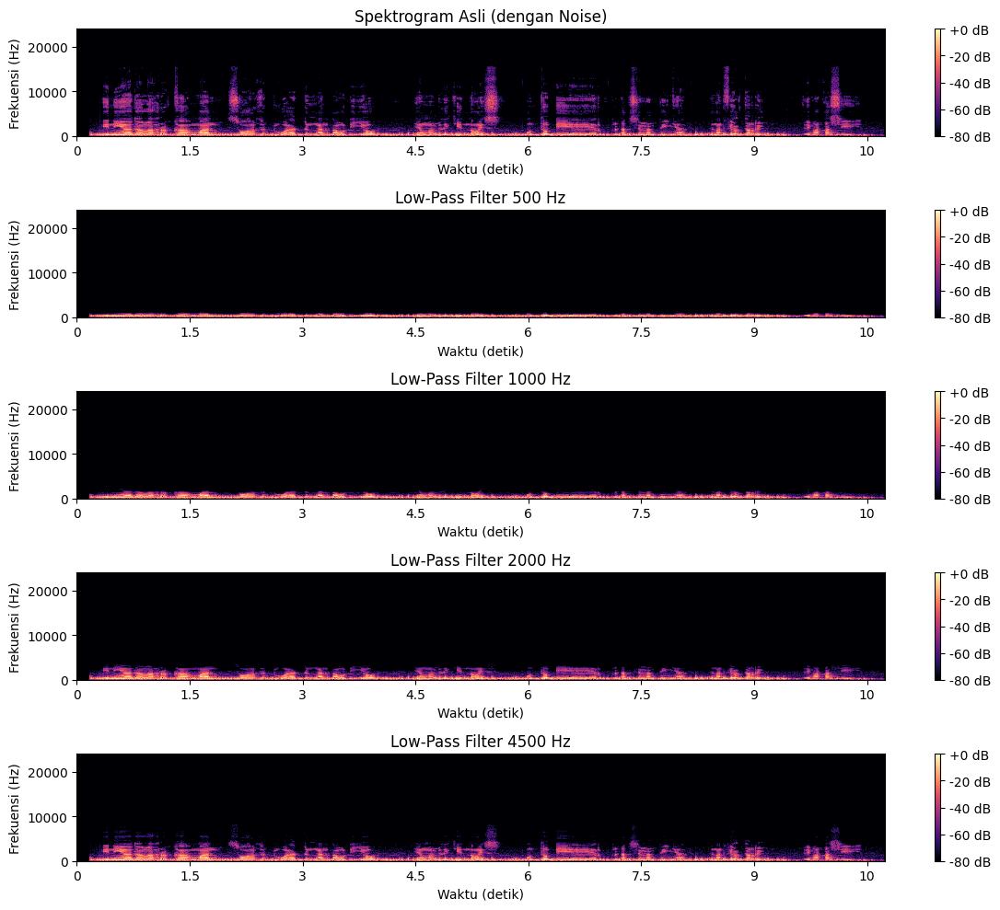

In [16]:
def butter_lowpass(cutoff, fs, order=4):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

def apply_lowpass(y, cutoff, sr, order=4):
    b, a = butter_lowpass(cutoff, sr, order)
    y_filtered = filtfilt(b, a, y)
    return y_filtered

cutoffs = [500, 1000, 2000, 4500]
filtered_signals = {}

for c in cutoffs:
    y_f = apply_lowpass(y, c, sr)
    filtered_signals[c] = y_f

    # Simpan hasil audio
    output_folder = os.path.join(base_path, "Audio2", "Output")
    os.makedirs(output_folder, exist_ok=True)
    output_path = os.path.join(output_folder, f"Audio-LP-{c}.wav")
    sf.write(output_path, y_f, sr)
    print(f"✅ File disimpan: {output_path}")

def plot_spectrogram(y, sr, title):
    D = librosa.stft(y, n_fft=1024, hop_length=256)
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    librosa.display.specshow(S_db, sr=sr, hop_length=256, x_axis='time', y_axis='hz')
    plt.title(title)
    plt.xlabel("Waktu (detik)")
    plt.ylabel("Frekuensi (Hz)")
    plt.colorbar(format="%+2.0f dB")

plt.figure(figsize=(12, 10))

# Spektrogram asli
plt.subplot(5, 1, 1)
plot_spectrogram(y, sr, "Spektrogram Asli (dengan Noise)")

# LPF cutoff 500 Hz
plt.subplot(5, 1, 2)
plot_spectrogram(filtered_signals[500], sr, "Low-Pass Filter 500 Hz")

# LPF cutoff 1000 Hz
plt.subplot(5, 1, 3)
plot_spectrogram(filtered_signals[1000], sr, "Low-Pass Filter 1000 Hz")

# LPF cutoff 2000 Hz
plt.subplot(5, 1, 4)
plot_spectrogram(filtered_signals[2000], sr, "Low-Pass Filter 2000 Hz")

# LPF cutoff 3500 Hz
plt.subplot(5, 1, 5)
plot_spectrogram(filtered_signals[4500], sr, "Low-Pass Filter 4500 Hz")

plt.tight_layout()
plt.show()


Pada filter Low-Pass saya menggunakan 4 cutoff yaitu 500, 1000, 2000, 4500 Hz. Lowpass adalah kebalikan dari high pass, dimaan detail frekuensi suara dibatasi di atas nilai cutoff, misalnya cutoff 500, maka nilai di atas frekuensi 500 Hz akan diblokir. Pada kasus ini, cutoff 500 dan 1000 menghilangkan detail frekuensi tinggi, sedangkan 2000 dan 4500 Hz cukup mengambil energi terbanyak pada frekuensi suara saya. Jika dilihat dari energi frekuensi suara awal, saya mengasumsi suara saya banyak tersebar di bawah 5000 Hz. Jika didengar seluruh audio masih memiliki noise suara kipas angin, karena filter ini tidak memotong batas bawah. Namun menurut saya, suara terbaik ada di cutoff 4500 Hz, karena suara saya lebih terdengar jelas.

✔ File disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-BP-300-3400.wav
✔ File disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-BP-500-2000.wav
✔ File disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-BP-700-3600.wav
✔ File disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-BP-800-2500.wav
✔ File disimpan: f:\STM\Worksheet3\assets\Audio2\Output\Audio-BP-1000-3500.wav


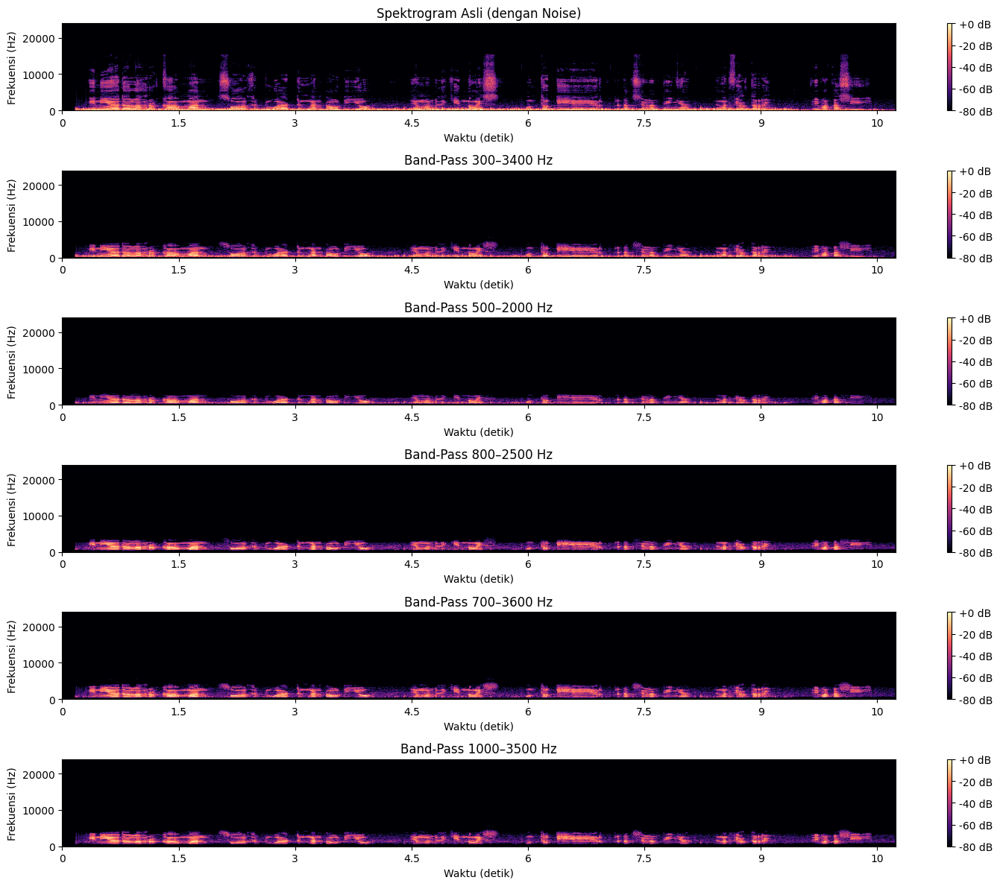

In [17]:
def butter_bandpass(lowcut, highcut, fs, order=4):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band', analog=False)
    return b, a

def apply_bandpass(y, lowcut, highcut, sr, order=4):
    b, a = butter_bandpass(lowcut, highcut, sr, order)
    y_filtered = filtfilt(b, a, y)
    return y_filtered

# Tentukan rentang frekuensi band-pass yang diuji
band_ranges = [(300, 3400), (500, 2000), (700, 3600), (800, 2500), (1000, 3500)]
filtered_signals = {}

# Terapkan filter dan simpan hasil audio
output_folder = os.path.join(base_path, "Audio2", "Output")
os.makedirs(output_folder, exist_ok=True)

for low, high in band_ranges:
    y_f = apply_bandpass(y, low, high, sr)
    filtered_signals[(low, high)] = y_f

    output_path = os.path.join(output_folder, f"Audio-BP-{low}-{high}.wav")
    sf.write(output_path, y_f, sr)
    print(f"✔ File disimpan: {output_path}")

# Fungsi untuk menampilkan spektrogram
def plot_spectrogram(y, sr, title):
    D = librosa.stft(y, n_fft=1024, hop_length=256)
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    librosa.display.specshow(S_db, sr=sr, hop_length=256, x_axis='time', y_axis='hz')
    plt.title(title)
    plt.xlabel("Waktu (detik)")
    plt.ylabel("Frekuensi (Hz)")
    plt.colorbar(format="%+2.0f dB")

# Visualisasi Spektrogram Asli & Hasil Filtering
plt.figure(figsize=(15, 12))

plt.subplot(6, 1, 1)
plot_spectrogram(y, sr, "Spektrogram Asli (dengan Noise)")

plt.subplot(6, 1, 2)
plot_spectrogram(filtered_signals[(300, 3400)], sr, "Band-Pass 300–3400 Hz")

plt.subplot(6, 1, 3)
plot_spectrogram(filtered_signals[(500, 2000)], sr, "Band-Pass 500–2000 Hz")

plt.subplot(6, 1, 4)
plot_spectrogram(filtered_signals[(800, 2500)], sr, "Band-Pass 800–2500 Hz")

plt.subplot(6, 1, 5)
plot_spectrogram(filtered_signals[(700, 3600)], sr, "Band-Pass 700–3600 Hz")

plt.subplot(6, 1, 6)
plot_spectrogram(filtered_signals[(1000, 3500)], sr, "Band-Pass 1000–3500 Hz")

plt.tight_layout()
plt.show()

Untuk filter bandpass adalah penggabungan kedua filter lowpass dan highpass, dimana mengambil sebaran frekuensi antara batas atas dan batas bawah yang disediakan pada cutoff, sehingga nilai di atas batas atasm, dan di bawah batas bawah akan dihilangkan. Terdapat 5 cutoff yang saya gunakan di sini, ada band_ranges = [(300, 3400), (500, 2000), (700, 3600), (800, 2500), (1000, 3500)]. Dari energi yang saya lihat rentang sebaran terbanyak ada di bawah 5000, dan sebaran noise kipas angin di bawah 800 ketas. Visualisasi spektogram dengan batas atas di atas 3000 Hz, lebih baik karena ada variasi frekuensi di angka tersebut. Setelah didengar langsung, suara dengan cutoff filter batas bawah 700 ke bawah, masih memiliki noise kipas angin. Sedangkan batas bawah 800 ke atas cenderung lebih sedikit noisenya. Sehingga dari hasil pendengaran saya bandpass dengan cutoff 1000-3500 memiliki audio yang terbaik pada filter band pass ini.

Dari ketiga filter yang dilakukan low pass kurang cocok untuk menangani noise kipas angin. Highpass cukup cocok karena memblokir frekuensi sebaran noise. Namun bandpass lebih cocok karena bisa mengambil frekuensi yang tepat untuk audio yang diamati. Dengan batas atas dan batas bawah pada filter bandpass memungkinkan menghilangkan detail frekuensi noise pada frekuensi yang sangat rendah dan tinggi. Untuk cutoff terbaiknya ada di bandpass 1000-3500 Hz, karena cukup mengambil detail frekuensi tinggi dan menghilangkan noise suara kipas angin. Dan kualitas suara yang dihasilkan jelas dan noise kipas cukup dihilangkan.

---

## 3. Pitch Shifting dan Audio Manipulation

### Tugas yang harus dilakukan:
- Melakukan pitch shifting pada rekaman soal 1 sehingga terdengar seperti chipmunk
- Visualisasikan dalam waveform dan spektogram, sebelum dan sesudah pitch shifting
- Jelaskan proses pitch shifting, meliputi parameter yang digunakan, perbedaan dalam representasi visual, pengaruh perubahan pitch pada kualitas suara
- Menggunakan dua pitch shifting berbedan dan menggabungkannya menjadi 1 audio.

**Path file:** `Audio1/audio25s.wav`

Dalam soal ini saya menggunakan pitch shifting dengan menambah 6 dan 12 semitone

---

### Kode Pemrosesan Audio

In [18]:
base_path = os.getcwd()
audio_path3 = os.path.join(base_path, "Audio1", "audio25s.wav")

y, sr = librosa.load(audio_path3, sr=None)

# Pitch Shifting
y_pitch_6 = librosa.effects.pitch_shift(y=y, sr=sr, n_steps=6)
y_pitch_12 = librosa.effects.pitch_shift(y=y, sr=sr, n_steps=12)

# Simpan hasil ke folder Audio1/Output
output_folder = os.path.join(base_path, "Audio1", "Output")
os.makedirs(output_folder, exist_ok=True)

path_pitch_6 = os.path.join(output_folder, "audio_pitch_6.wav")
path_pitch_12 = os.path.join(output_folder, "audio_pitch_12.wav")

sf.write(path_pitch_6, y_pitch_6, sr)
sf.write(path_pitch_12, y_pitch_12, sr)

print("✅ File audio hasil pitch shift disimpan di:")
print(f"- {path_pitch_6}")
print(f"- {path_pitch_12}")

✅ File audio hasil pitch shift disimpan di:
- f:\STM\Worksheet3\assets\Audio1\Output\audio_pitch_6.wav
- f:\STM\Worksheet3\assets\Audio1\Output\audio_pitch_12.wav


PParameter yang digunakan dalam proses *pitch shifting* dijabarkan dalam kode berikut:

```python
librosa.effects.pitch_shift(y, sr=sr, n_steps=6)
librosa.effects.pitch_shift(y, sr=sr, n_steps=12)
```

Fungsi `librosa.effects.pitch_shift` untuk mengubah pitch tanpa mengubah durasi menggunakan algoritma phase vocoder. Dengan `y` adalah sinyal audio yang dibaca dari file berisi data ampiltudo dari sinyal waktu, `sr` adalah sampling rate yang berukuran 48000Hz, `n_steps` adalah jumlah pergeseran pitch dalam satuan semitone, dalam hal ini saya menggunakan 6 semitone atau setengah oktaf, dan 12 semitone atau 1 oktaf.


In [19]:
print("\n🎧 Audio Asli:")
display(Audio(y, rate=sr))
print("🎵 Audio Pitch +6:")
display(Audio(y_pitch_6, rate=sr))
print("🎶 Audio Pitch +12:")
display(Audio(y_pitch_12, rate=sr))


🎧 Audio Asli:


🎵 Audio Pitch +6:


🎶 Audio Pitch +12:


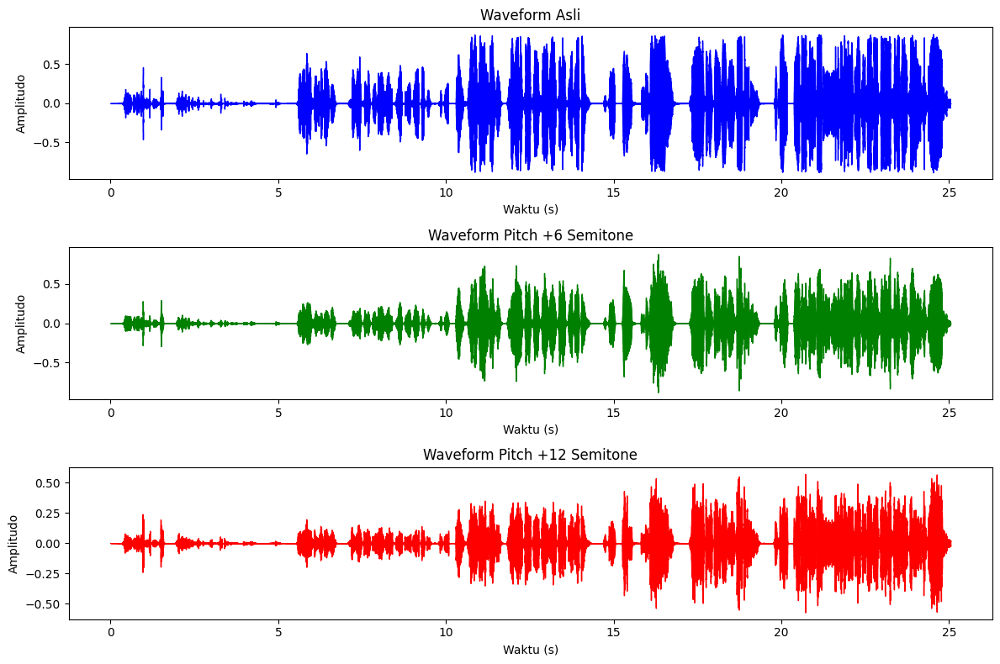

In [20]:
fig_wave, axes_wave = plt.subplots(3, 1, figsize=(12, 8))

# Waveform Asli
librosa.display.waveshow(y, sr=sr, ax=axes_wave[0], color='b')
axes_wave[0].set_title("Waveform Asli")
axes_wave[0].set_xlabel("Waktu (s)")
axes_wave[0].set_ylabel("Amplitudo")

# Waveform Pitch +6
librosa.display.waveshow(y_pitch_6, sr=sr, ax=axes_wave[1], color='g')
axes_wave[1].set_title("Waveform Pitch +6 Semitone")
axes_wave[1].set_xlabel("Waktu (s)")
axes_wave[1].set_ylabel("Amplitudo")

# Waveform Pitch +12
librosa.display.waveshow(y_pitch_12, sr=sr, ax=axes_wave[2], color='r')
axes_wave[2].set_title("Waveform Pitch +12 Semitone")
axes_wave[2].set_xlabel("Waktu (s)")
axes_wave[2].set_ylabel("Amplitudo")

plt.tight_layout()
plt.show()

Bantuk yang dihasilkan dari ketiga waveform cukup berbeda. Waveform asli yang berwarna biru, +6 semitone warna hijau, dan +12 semitone berwarna merah, dengan urutan suara dari bisikan, normal, keras, melengking, dan teriak. Amplitudo disini mewakili kekerasan suara atau kenyaringan. Disini suara bisikan cukup mirip untuk ketiga waveform. Namun untuk suara normal dan keras terdapat perubahan pada visualisasi polanya, dimana waveform setelah pitch shifting lebih menurun amplitudonya, yang kemungkinan suara lebih pelan atau tidak nyaring. Untuk suara melengking dan keras sama seperti sebelumnya, pola lebih kecil amplitudonya dan lebih rapat.

---

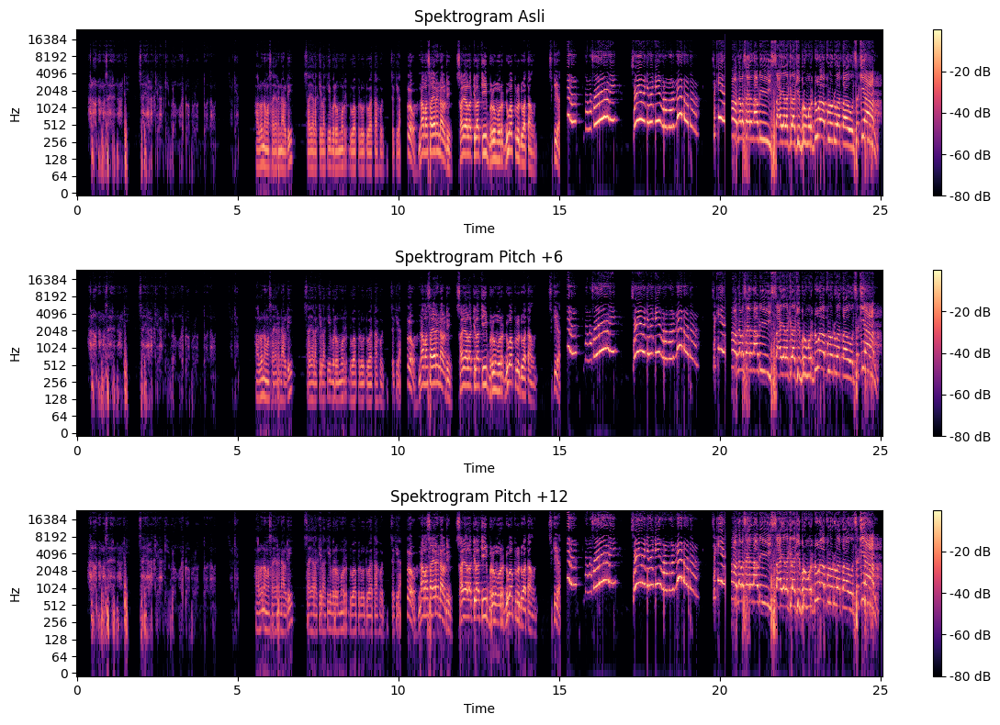

In [21]:
fig_spec, axes_spec = plt.subplots(3, 1, figsize=(12, 8))

# Spektrogram Asli
D = librosa.amplitude_to_db(abs(librosa.stft(y)), ref=np.max)
img1 = librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log', ax=axes_spec[0])
axes_spec[0].set_title("Spektrogram Asli")
fig_spec.colorbar(img1, ax=axes_spec[0], format="%+2.f dB")

# Spektrogram Pitch +6
D6 = librosa.amplitude_to_db(abs(librosa.stft(y_pitch_6)), ref=np.max)
img2 = librosa.display.specshow(D6, sr=sr, x_axis='time', y_axis='log', ax=axes_spec[1])
axes_spec[1].set_title("Spektrogram Pitch +6")
fig_spec.colorbar(img2, ax=axes_spec[1], format="%+2.f dB")

# Spektrogram Pitch +12
D12 = librosa.amplitude_to_db(abs(librosa.stft(y_pitch_12)), ref=np.max)
img3 = librosa.display.specshow(D12, sr=sr, x_axis='time', y_axis='log', ax=axes_spec[2])
axes_spec[2].set_title("Spektrogram Pitch +12")
fig_spec.colorbar(img3, ax=axes_spec[2], format="%+2.f dB")

plt.tight_layout()
plt.show()

Pada tampilan spektogram terdapat perbedaan yang cukup signifikan, dimana energi frekuensinya berubah. Batas atas frekuensi dinaikkan, pada +6 dan +12 terdapat kenaikan untuk setiap energi, seperti pada detik 5 hingga 15 ada pusat energi yang di awal detik 5 ada di 64Hz keatas, namun pada spektogram +6 semitone pusatnya dimulai 100Hz-an dan pada +12 semitone pusatnuya naik di mulai angka 128Hz. Artinya ketika pitch dinaikkan sebaran energi frekuensi pada spektogram juga dinaikkan, alias frekuensi dinaikkan seiring naiknya semitone pada proses pitch shifting.


Untuk kualitas yang dihasilkan pada hasil audionya, pada suara bisik-bisik, tidak memberikan informasi suara yang jelas jika dinaikkan 12 semitone. Namun untuk kasus 6 semitone dinaikkan suara terdengar lebih tinggi dan lebih “ringan”, tetapi masih cukup alami. Sedangkan pada kasus 12 semitone dinaikkan Suara menjadi jauh lebih tinggi, terdengar seperti versi cepat atau suara anak kecil, dan kejernihan menurun karena formant juga ikut naik.

---

## 4. Audio Processing Chain

### Tugas yang harus dilakukan:
- Dengan audio hasil pitch shifting pada soal 3, lakukan proses audio dengna tahap Equalizer, Gain/fade, Normalization, Compression, Noise Gate, Silence trimming.
- Target loudness -16 LUFS
- Visualisasikan waveform dan spektogram sebelum dan sesudah normalisasi
- Jelaskan perubahan dinamika suara, normalisasi peak dan normalisasi LUFS, bagaimana kualitas suara setelah proses normalisasi dan loudness optimatization, dan kelebihan kekurangan dari pengoptimalan loudness pada konteks rekaman suara.

**Path file:** `Audio4/audio_pitch_shifting.wav`

Dalam soal ini audio berdurasi 50 detik, dengan 25 detik awal audio dengan pitch shifting +6 semitone, dan 25 detik berikutnya pitch shifting +12 semitone.

---

### Kode Pemrosesan Audio

In [22]:
import pyloudnorm as pyln
from scipy.signal import butter, lfilter
from scipy.signal import butter, lfilter
audio_path = os.path.join(base_path, "Audio4", "audio_pitch_shifting.wav")

In [23]:
y, sr = librosa.load(audio_path, sr=None)
print(f"Sample rate: {sr}, durasi: {len(y)/sr:.2f}s")

#Equalizer
def bandpass_filter(data, lowcut, highcut, sr, order=4):
    nyquist = 0.5 * sr
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return lfilter(b, a, data)

y_eq = bandpass_filter(y, 150, 6000, sr)

#Gain / Fade
gain_db = 2
y_gain = y_eq * (10 ** (gain_db / 20))
fade_len = int(0.05 * len(y_gain))
fade_in = np.linspace(0, 1, fade_len)
fade_out = np.linspace(1, 0, fade_len)
y_gain[:fade_len] *= fade_in
y_gain[-fade_len:] *= fade_out

#Normalization (LUFS Target -16 LUFS)
meter = pyln.Meter(sr)
loudness = meter.integrated_loudness(y_gain)
y_norm = pyln.normalize.loudness(y_gain, loudness, -16.0)
print(f"Loudness sebelum: {loudness:.2f} LUFS → sesudah: -16 LUFS")

#Compression
def compressor(signal, threshold_db=-22, ratio=2.5, makeup_gain_db=4):
    threshold = 10 ** (threshold_db / 20)
    makeup_gain = 10 ** (makeup_gain_db / 20)
    compressed = np.copy(signal)
    over = np.abs(signal) > threshold
    compressed[over] = np.sign(signal[over]) * (threshold + (np.abs(signal[over]) - threshold) / ratio)
    return compressed * makeup_gain

y_comp = compressor(y_norm)

#Noise Gate
threshold_gate = 0.015
y_gate = np.where(np.abs(y_comp) < threshold_gate, 0, y_comp)

#7. Silence trimming
y_trim, _ = librosa.effects.trim(y_gate, top_db=25)

#Penyimpanan audio setelah proses 
output_folder = os.path.join(base_path, "Audio4", "Output")
os.makedirs(output_folder, exist_ok=True)
path_output = os.path.join(output_folder, "audio_processed_final.wav")
sf.write(path_output, y_trim, sr)
print(f"Audio hasil processing disimpan di: {path_output}")


Sample rate: 48000, durasi: 50.09s
Loudness sebelum: -16.27 LUFS → sesudah: -16 LUFS


c:\Users\ANSEN\.conda\envs\handson\Lib\site-packages\pyloudnorm\normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


Audio hasil processing disimpan di: f:\STM\Worksheet3\assets\Audio4\Output\audio_processed_final.wav


Ada beberapa paramater yang digunakan dalam proses audio pada kode di atas.
1. Equilizer dengan `(bandpass_filter(y, 150, 6000, sr))`, yang akan menyaring frekuensi diluar rentang 150-6000Hz.
2. Gain, `gain_db = +2` `fade_len = 5% durasi`. Amplitudo dinaikkan, dan fade 5% membuat transisi awal dan akhir lebih halus untuk mencegah suara mendadak hilang atau muncul
3. Normalisasi `target = -16 LUFS`, tingkat loudness audio dengan standar platform Youtube atau Spotify.
4. Compression `threshold = -22 dB` `ratio = 2` `makeup_gain = +5 dB`. Menekan bagian suara yang keras agar tidak menonjol (di atas -20dB dikompres dengan rasio 2,5:1). Dan menaikkan level keseluruhan setelah dikompresi.
5. Noise Gate, `threshold = 0.015`. Bagian suara dengan amplitudo <0,02 akan dihilangkan.
6. Silence Trimming, `top_db = 25`. Memotong bagian awal/akhir yang volume-nya >25 dB lebih kecil dari puncak.

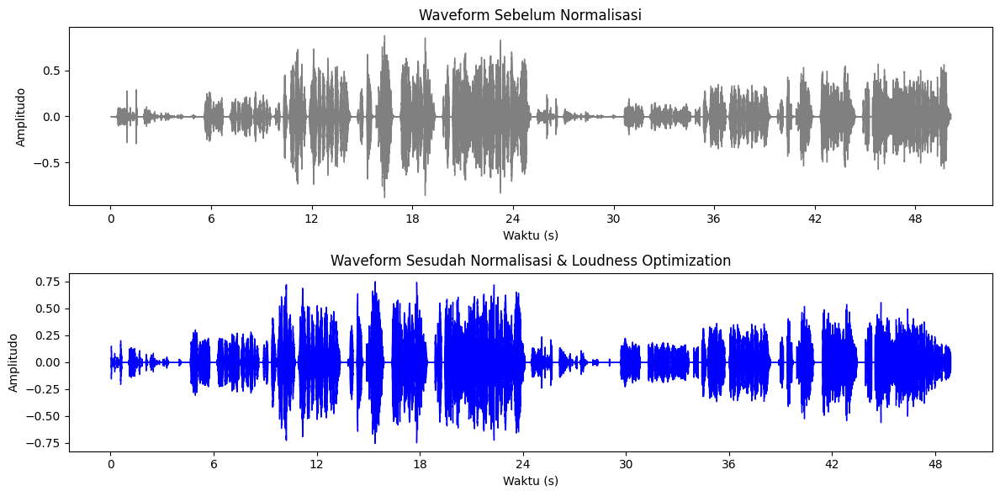

In [24]:
fig, axes = plt.subplots(2, 1, figsize=(12, 6))

# Waveform sebelum normalisasi
librosa.display.waveshow(y, sr=sr, ax=axes[0], color='gray')
axes[0].set_title("Waveform Sebelum Normalisasi")
axes[0].set_xlabel("Waktu (s)")
axes[0].set_ylabel("Amplitudo")

# Waveform sesudah normalisasi
librosa.display.waveshow(y_trim, sr=sr, ax=axes[1], color='b')
axes[1].set_title("Waveform Sesudah Normalisasi & Loudness Optimization")
axes[1].set_xlabel("Waktu (s)")
axes[1].set_ylabel("Amplitudo")

plt.tight_layout()
plt.show()

Dari waveform yang ditampilkan terlihat amplitudo yang sangat kecil atau noise ditiadakan, ditandai dengan garis. Memiliki transisi yang lebih halus, dan terdapat peningkatan ampliduo pada beberapa amplitudo yang kecil seperti pada detik 5 hingga 9, dan 30 hingga 34. Gelombang awal yang diam atau garis pada waveform sebelum normalisasi, dhilangkan pada waveform setelah normalisasi.

---

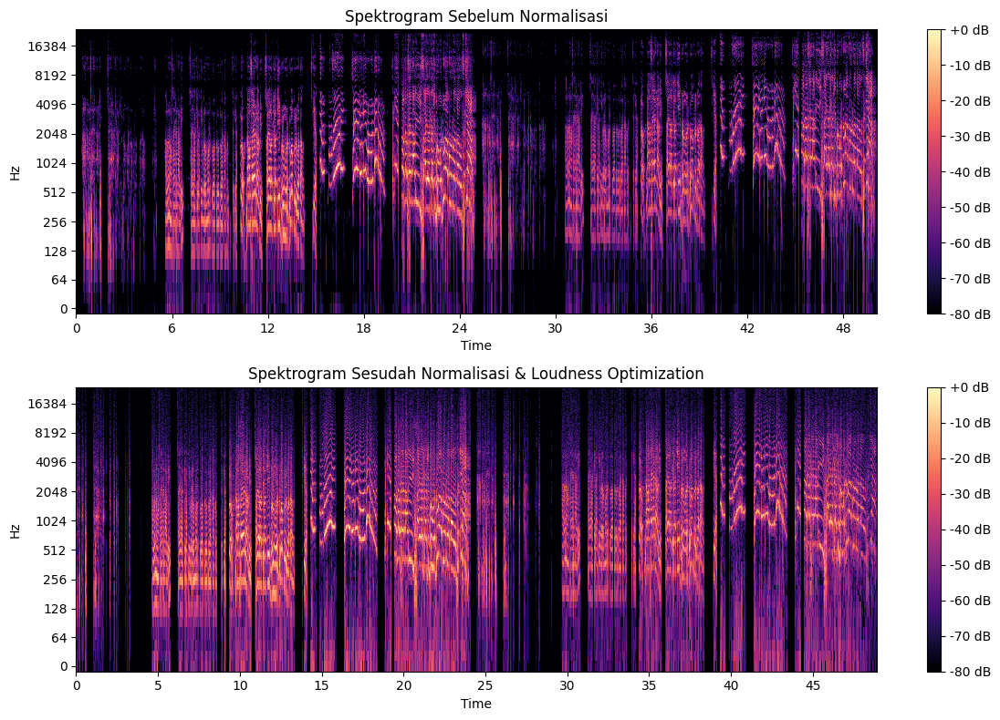

In [25]:
D_before = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
D_after = librosa.amplitude_to_db(np.abs(librosa.stft(y_trim)), ref=np.max)

fig, axes = plt.subplots(2, 1, figsize=(12, 8))

img1 = librosa.display.specshow(
    D_before, sr=sr, x_axis='time', y_axis='log', ax=axes[0], cmap='magma'
)
axes[0].set_title("Spektrogram Sebelum Normalisasi")
fig.colorbar(img1, ax=axes[0], format="%+2.0f dB")

img2 = librosa.display.specshow(
    D_after, sr=sr, x_axis='time', y_axis='log', ax=axes[1], cmap='magma'
)
axes[1].set_title("Spektrogram Sesudah Normalisasi & Loudness Optimization")
fig.colorbar(img2, ax=axes[1], format="%+2.0f dB")

plt.tight_layout()
plt.show()

Dari dua spektogram di atas:

Sebelum normalisasi, terlihat rentang amplitudo dan intensitas warna yang bervariasi lebih ekstrem — bagian keras (merah terang) dan bagian lembut (gelap) kontras sekali. Ini menunjukkan dinamika lebar: perbedaan besar antara bagian keras dan lembut.

Sesudah normalisasi & loudness optimization, area spektrum tampak lebih merata dan stabil, warna kuning–oranye lebih konsisten di sepanjang waktu. Ini menandakan kompresi dan normalisasi loudness telah meratakan volume, bagian yang tadinya pelan dinaikkan, sementara puncak keras sedikit ditekan.

Akibatnya tidak ada lonjakan tajam volume antarbagian. Suara terdengar lebih padat, rata. Namun pada suara bisikan detik-detik awal, suara tidak jelas, kemunkinan akibat dari penaikan pitch yang kurang tepat. Dan suara lainnya cenderung punya volume yang sama, tidak ada yang melengking atau berbeda oktaf, yang tidak seperti sebelum normalisasi.

---

Kelebihan:
1. Konsistensi volume: Pengoptimalan loudness membuat tingkat kekerasan suara lebih stabil di seluruh bagian rekaman, sehingga tidak ada bagian yang terlalu pelan atau terlalu keras.
2. Kenyamanan pendengaran: Rekaman menjadi lebih nyaman didengar pada berbagai perangkat dan lingkungan, terutama untuk platform streaming yang menstandarkan loudness (misalnya −16 LUFS).
3. Kualitas persepsi yang meningkat: Dengan penyesuaian loudness yang tepat, detail suara terdengar lebih jelas dan profesional.

Kekurangan:
1. Kehilangan dinamika alami: Proses optimasi yang terlalu agresif dapat mengurangi perbedaan antara bagian pelan dan keras, sehingga rekaman terdengar datar.
2. Potensi distorsi: Jika dilakukan berlebihan, peningkatan loudness dapat menyebabkan clipping atau artefak distorsi.
3. Menurunnya ekspresivitas: Dalam konteks musik atau vokal, variasi volume yang alami berkontribusi terhadap ekspresi emosional; optimasi berlebihan dapat mengurangi nuansa tersebut.

---

## 5. Music Analysis dan Remix

Pilih 2 potongan lagu yang memiliki vokal (penyanyi) berdurasi 1 menit.
1. Lagu nuansa sedih, lambat
2. Lagu nuansa ceria, cepat

---

### Tugas yang harus dilakukan:
- Deteksi tempo (BPM) dan estimasi kunci (key) dari masing masing lagu dan berikan analisis singkat
- Lakukan remix kedua lagu, Time Strect (menyamakan tempo), Pitch Shift (menyamakan kunci), Crossfading (menggabungkan kedua lagu dengan efek crossfading)
- Jelaskan proses dan parameter yang digunakan
- Visualisasikan waveform dan spektogram
- Jelaskan hasil remix yang telah dilakukan

**Path file:** `Audio3/laguceria.wav` `Audio3/lagusedih.wav`

Pada laguceria.wav berisi lagu "Believer" dari Imagine Dragon, dan lagusedih.wav berisi lagu "When I Was Your Man" dari Bruno Mars

### Kode Pemrosesan Audio

In [26]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import soundfile as sf
import os

base_path = os.getcwd()
audio_path5 = os.path.join(base_path, "Audio3", "laguceria.wav")
audio_path6 = os.path.join(base_path, "Audio3", "lagusedih.wav")

In [27]:
y_ceria, sr_ceria = librosa.load(audio_path5, sr=None)
y_sedih, sr_sedih = librosa.load(audio_path6, sr=None)

#Deteksi tempo (BPM)
tempo_ceria, _ = librosa.beat.beat_track(y=y_ceria, sr=sr_ceria)
tempo_sedih, _ = librosa.beat.beat_track(y=y_sedih, sr=sr_sedih)

tempo_ceria = float(tempo_ceria[0]) if isinstance(tempo_ceria, np.ndarray) else float(tempo_ceria)
tempo_sedih = float(tempo_sedih[0]) if isinstance(tempo_sedih, np.ndarray) else float(tempo_sedih)

#Estimasi Key menggunakan Chroma
def estimate_key(y, sr):
    chroma = librosa.feature.chroma_stft(y=y, sr=sr)
    chroma_mean = chroma.mean(axis=1)
    note_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    key_index = chroma_mean.argmax()
    return note_names[key_index]

key_sedih = estimate_key(y_sedih, sr_sedih)
key_ceria = estimate_key(y_ceria, sr_ceria)

print(f"Lagu Ceria  -> Tempo: {tempo_ceria:.2f} BPM, Key: {key_ceria}")
print(f"Lagu Sedih  -> Tempo: {tempo_sedih:.2f} BPM, Key: {key_sedih}")

Lagu Ceria  -> Tempo: 126.05 BPM, Key: A#
Lagu Sedih  -> Tempo: 72.79 BPM, Key: E


Disini inisiasi terlebih dahulu untuk kedua audio lagu sedih dan ceria, dari data dan sampling ratenya. `sr=None` artinya tidak ada proses resampling. 
Fungsi `librosa.beat.beat_track(y=y_ceria, sr=sr_ceria)` untuk menganalisis pola ketukan pada sinyal audio yang menggunakan onset strength envelope (perubahan energi suara pada rentang waktu) untuk mendeteksi periode ketukan.
`float(tempo_ceria[0]) if isinstance(tempo_ceria, np.ndarray) else float(tempo_ceria)` untuk memastikan tempo_ceria dan tempo_sedih berupa angka (mis. 120.5), bukan array seperti [120.5].

Fungsi `estimate_key(y, sr)` berisi `librosa.feature.chroma_stft()` yang menghitung fitur chroma yaitu representasi energi suara 12 nada musik (C hingga B). `chroma.mean(axis=1)` untuk mengambil rata rata energi setiap nada. Dan `argmax()` untuk menbamil nada dengan energi tertinggi, yang nantinya dijadikan kunci dominan lagu.

Dari hasil proses perhitungan ketukan per detik, dan kunci dominan kedua lagu, adalah lagu sedih (When I Was Your Man) memiliki 72,79 BPM, dan kunci E, sedangkan lagu ceria (Believer) dengan tempo 12,05 BPM dengan kunci utama A#.

In [29]:
#Target Tempo
target_tempo = (tempo_ceria + tempo_sedih) / 2
stretch_factor_ceria = target_tempo / tempo_ceria
stretch_factor_sedih = target_tempo / tempo_sedih

#Time Stretching
y_ceria_stretch = librosa.effects.time_stretch(y_ceria, rate=stretch_factor_ceria)
y_sedih_stretch = librosa.effects.time_stretch(y_sedih, rate=stretch_factor_sedih)

#Pitch Shift agar harmonis
y_ceria_pitch = librosa.effects.pitch_shift(y_ceria_stretch, sr=sr_ceria, n_steps=-3)
y_sedih_pitch = librosa.effects.pitch_shift(y_sedih_stretch, sr=sr_sedih, n_steps=+3)

#Crossfade Dinamis
crossfade_duration = 5  #transisi lagu sedih
crossfade_len = int(sr_ceria * crossfade_duration)

#Jeda sebelum lagu ceria 4 detik
offset_delay = int(sr_ceria * 4) 
y_ceria_padded = np.concatenate([np.zeros(offset_delay), y_ceria_pitch])

# Opsi 3 — Gunakan kurva crossfade non-linear agar smooth
fade_in = np.sin(np.linspace(0, np.pi / 2, crossfade_len)) ** 2
fade_out = np.cos(np.linspace(0, np.pi / 2, crossfade_len)) ** 2

#Crossfade dilakukan di akhir lagu sedih dan awal lagu ceria
crossfaded = (
    y_sedih_pitch[-crossfade_len:] * fade_out +
    y_ceria_padded[:crossfade_len] * fade_in
)

#Satukan hasil akhir
remix = np.concatenate([
    y_sedih_pitch[:-crossfade_len],
    crossfaded,
    y_ceria_padded[crossfade_len:]
])

Untuk tahapan remix audio dimulai dari menyamakan tempo kedua lagu dengan `target_tempo = (tempo_ceria + tempo_sedih) / 2`  dari bpm yang dihasilkan di kode sebelumnya dirata-ratakan menjadi 139 bpm. `stretch_factor_ceria = target_tempo / tempo_ceria` untuk menjadi rasio percepatan atau perlambatan masing masing audio berdasarkan bpm target tempo. Maka untuk lagu ceria akan diperlambat dan lagu sedih dipercepat dengan fungsi `librosa.effects.time_stretch(y, rate=x)`. Dan pitch untuk karena lagu sedih berada di E, dan lagu ceria berada di A#, keduanya memiliki perbedaan beberapa semitone, dimana E, F, F#, G, G#, A, A#. Sehingga saya mengambil titik tengah yaitu G, sehingga lagu ceria turun 3 semitone, dan lagu sedih naik 3 semitone. Untuk menaikkannya menggunakan `librosa.effects.pitch_shift(y_ceria_stretch, sr=sr_ceria, n_steps=-3)` dengan n_step adalah jumlah semitone yang diubah, dan sr adalah sampling rate masing masing audio.

`crossfade_duration = 5` untuk menentukan lama transisi (5 detik). `crossfade_len` untuk satuan sample yang akan dijadikan parameter pada proses fade di penyatuan audio. `offset_delay = 4` untuk memberi jeda 4 detik sebelum lagu kedua (ceria) mulai masuk. `fade_in` dan `fade_out` untuk membuat kurva volume sinusoidal agar transisi terdengar lembut dimana. Volume lagu ceria naik perlahan, dan lagu sedih turun perlahan. `crossfaded` bertujuan untuk menggabungkan faded dengan mangambil ujung audio dan dijadikan transisi, dan `np.concatenate([...])` untuk menggabungkan kedua audio dengan transisi di tengahnya.

In [30]:
#Hasil Remix Disimpan
output_path = os.path.join(base_path, "Audio3", "lagu_remix.wav")
sf.write(output_path, remix, sr_ceria)
print(f"Hasil remix disimpan di: {output_path}")


Hasil remix disimpan di: f:\STM\Worksheet3\assets\Audio3\lagu_remix.wav


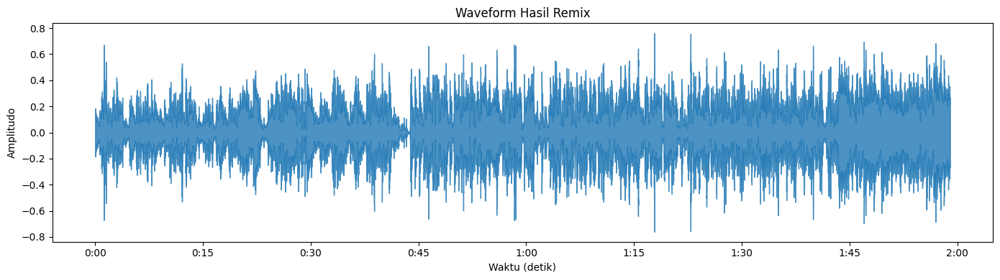

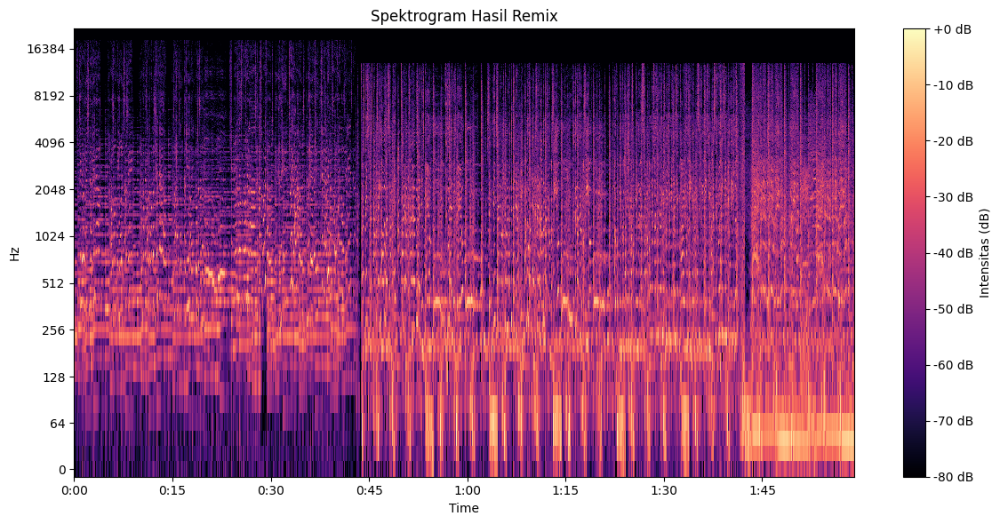

In [31]:
#Waveform Hasil Remix
plt.figure(figsize=(14, 4))
librosa.display.waveshow(remix, sr=sr_ceria, alpha=0.8)
plt.title("Waveform Hasil Remix")
plt.xlabel("Waktu (detik)")
plt.ylabel("Amplitudo")
plt.tight_layout()
plt.show()

#Spektrogram Hasil Remix ===
plt.figure(figsize=(12, 6))
D_mix = librosa.amplitude_to_db(np.abs(librosa.stft(remix)), ref=np.max)
librosa.display.specshow(D_mix, sr=sr_ceria, x_axis='time', y_axis='log', cmap='magma')
plt.title("Spektrogram Hasil Remix")
plt.colorbar(format="%+2.0f dB", label="Intensitas (dB)")
plt.tight_layout()
plt.show()

In [ ]:
Audio(output_path)

In [32]:
print(f"Perubahan tempo : {stretch_factor_ceria} diturunkan pada lagu ceria.")
print(f"Perubahan tempo :{stretch_factor_sedih} diturunkan pada lagu sedih.")
print(f"Durasi crossfade: {crossfade_duration} detik")
print(f"Jumlah titik sample pada Crossfade : {crossfade_len}")
print(f"Offset delay sebelum lagu ceria: {offset_delay} sampel atau {offset_delay / sr_ceria} detik" )

Perubahan tempo : 0.7887323943661972 diturunkan pada lagu ceria.
Perubahan tempo :1.3658536585365855 diturunkan pada lagu sedih.
Durasi crossfade: 5 detik
Jumlah titik sample pada Crossfade : 220500
Offset delay sebelum lagu ceria: 176400 sampel atau 4.0 detik


Hasil dari visualnya cukup stabil meskipun durasi dari lagu sedih lebih kecil karena adanya percepatan. Untuk kerapatan sinyal, lagu ceria lebih rapat, namun kedua lagu stabil amplitudonya. Energi frekuensi lagu sedih fokus pada frekuensi 128 hingga 700Hz. Dan lagu ceria dari 0 hingga 700 Hz. Namun untuk lagu hasil penggabungannya, lagu sedihnya sedikit terlalu cepat, namun lagu ceria sangat lambat, sehingga proses target temponya menurut saya kurang sesuai jika diambil titik tengah dari tempo kedua lagu. Dan pitchnya juga tidak bisa diambil titik tengahnya, karena dari chromanya sendiri menentukan kunci dominan. Untuk parameter remix awal, tempo lagu ceria diturunkan 0,788 kali dan lagu sedih dipercepat 1,365 kali. Dan durasi fadingnya 5 detik serta delay lagu ceria 4 detik. Saya sedikit memodifikasi agar kecepatan dan nadanya sedikit sesuai. Dan durasi Saya mengubah agar tempo lagu ceria sama dengan awal, dan tempo sedih dinaikkan 1,15. Dan pitchnya untuk lagu ceria sama, dan lagu sedih dinaikkan 2 semitone. Sedangkan untuk fadenya untuk lagu sedih 4 detik fade, dan 4 detik delay untuk lagu ceria.

---

In [33]:
#Target Tempo
stretch_factor_ceria_2 = 1
stretch_factor_sedih_2 = 1.15

#Time Stretching
y_ceria_stretch_2 = librosa.effects.time_stretch(y_ceria, rate=stretch_factor_ceria_2)
y_sedih_stretch_2 = librosa.effects.time_stretch(y_sedih, rate=stretch_factor_sedih_2)

#Pitch Shift agar harmonis
y_ceria_pitch = librosa.effects.pitch_shift(y_ceria_stretch_2, sr=sr_ceria, n_steps=+0)
y_sedih_pitch = librosa.effects.pitch_shift(y_sedih_stretch_2, sr=sr_sedih, n_steps=+1)

#Crossfade Dinamis
crossfade_duration = 4  # detik (lebih panjang untuk transisi lembut)
crossfade_len = int(sr_ceria * crossfade_duration)

# Opsi 2 — Tambahkan jeda sebelum lagu ceria masuk
offset_delay = int(sr_ceria * 3)  # delay 3 detik
y_ceria_padded = np.concatenate([np.zeros(offset_delay), y_ceria_pitch])

# Opsi 3 — Gunakan kurva crossfade non-linear agar smooth
fade_in = np.sin(np.linspace(0, np.pi / 2, crossfade_len)) ** 2
fade_out = np.cos(np.linspace(0, np.pi / 2, crossfade_len)) ** 2

# Crossfade dilakukan di akhir lagu sedih dan awal lagu ceria
crossfaded = (
    y_sedih_pitch[-crossfade_len:] * fade_out +
    y_ceria_padded[:crossfade_len] * fade_in
)

# Satukan hasil akhir
remix = np.concatenate([
    y_sedih_pitch[:-crossfade_len],
    crossfaded,
    y_ceria_padded[crossfade_len:]
])

output_path_2 = os.path.join(base_path, "Audio3", "lagu_remix_2.wav")
sf.write(output_path_2, remix, sr_ceria)
print(f"Hasil remix disimpan di: {output_path_2}")


Hasil remix disimpan di: f:\STM\Worksheet3\assets\Audio3\lagu_remix_2.wav


In [34]:
Audio(output_path_2)

Hasil lagu yang dihasilkan lebih baik dari temp, pitch, dan durasi fadenya.

---

## Sumber Data & Referensi

- **Audio:** 
1. [When I Was Your Man by Bruno Mars](https://youtu.be/ekzHIouo8Q4?si=HnGZVFOz3liUX-xg) 
2. [Believer by Imagine Dragon](https://youtu.be/7wtfhZwyrcc?si=eqFamxmWE0EBIpsg)

- **Referensi teknis:** 
1. [ButterWorth Filter](https://scikit-image.org/docs/stable/auto_examples/filters/plot_butterworth.html)
2. [Rekaman percakapan ChatGPT](https://chatgpt.com/share/68f251e7-bec0-8009-a6c8-63676c07caae)

### Lampiran

- **Repository Github Penugasan** : [Github](https://github.com/anzensirc/Worksheet-Sistem-Teknologi-Multimedia)